# **Category Assigned: Coca Cola**

**Note:** 

*Lower accuracy for canned packaging was observed. The reason could be fewer images with diverse styles of images collected (cans in refrigerator, cans placed on shelves, cans wrapped in plastic packaging etc.). The model accuracy for bottled packaging is higher as greater number of annotations were used. However, a more accurate model can only be trained if all the different sub-packaging styles are taken into account while training. Only data avaiable in Pakistani Market was used.*



**Summary for previous run:**

Model: "*COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml*"

Number of Iterations = 3000

Training Images = 82

Validation Images = 14


|   category    | #instances   |   category    | #instances   |   category    | #instances   |
|:-------------:|:-------------|:-------------:|:-------------|:-------------:|:-------------|
| Coca_Gen_Bo.. | 433          | Coca_Diet_B.. | 10           | Coca_Zero_B.. | 17           |
| Can_Coca_Gen  | 212          | Coca_NoSuga.. | 39           | Pepsi_Gen_B.. | 103          |
| Pepsi_NoSug.. | 6            | Sting_Gen_B.. | 77           | Fanta/Mirin.. | 192          |
| Can_Fanta/M.. | 77           |     Unsee     | 47           |               |              |
|     total     | 1213         |               |              |               |              |


[09/20 13:36:00 d2.evaluation.coco_evaluation]: Per-category bbox AP: 

| category             | AP     | category            | AP     | category             | AP     |
|:---------------------|:-------|:--------------------|:-------|:---------------------|:-------|
| Coca_Gen_Bottle      | 89.100 | Coca_Diet_Bottle    | 81.287 | Coca_Zero_Bottle     | 77.660 |
| Can_Coca_Gen         | 69.485 | Coca_NoSugar_Bottle | 73.554 | Pepsi_Gen_Bottle     | 84.362 |
| Pepsi_NoSugar_Bottle | 68.333 | Sting_Gen_Bottle    | 90.416 | Fanta/Mirinda_Bottle | 81.965 |
| Can_Fanta/Mirinda    | 27.109 | Unsee               | nan    |                      |        |

[09/20 13:36:00 d2.evaluation.coco_evaluation]: Per-category segm AP: 

| category             | AP     | category            | AP     | category             | AP     |
|:---------------------|:-------|:--------------------|:-------|:---------------------|:-------|
| Coca_Gen_Bottle      | 89.186 | Coca_Diet_Bottle    | 90.000 | Coca_Zero_Bottle     | 84.697 |
| Can_Coca_Gen         | 75.794 | Coca_NoSugar_Bottle | 79.937 | Pepsi_Gen_Bottle     | 85.407 |
| Pepsi_NoSugar_Bottle | 88.317 | Sting_Gen_Bottle    | 90.520 | Fanta/Mirinda_Bottle | 86.017 |
| Can_Fanta/Mirinda    | 30.446 | Unsee               | nan    |                      |        |

Mount Google Drive

In [1]:
#@title
#access Google Drive 
from google.colab import drive
drive.mount('/content/drive', force_remount=False)

Mounted at /content/drive


 **1. Detectron 2 Installation**

In [2]:
#@title
# install dependencies: 
!pip install pyyaml==5.1 pycocotools>=2.0.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

1.6.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [3]:
#@title
# install detectron2: (Colab has CUDA 10.1 + torch 1.6)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
assert torch.__version__.startswith("1.6")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.6/index.html
     |████████████████████████████████| 6.6MB 49.6MB/s 
     |████████████████████████████████| 2.2MB 9.6MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.2.post20200912-cp36-none-any.whl size=43996 sha256=de8609f508abfaa8eeec420d965f00fabdf371918649ba33f54e81307617345f
  Stored in directory: /root/.cache/pip/wheels/34/41/7b/f0a0b5800bea0474ae553342bde52093fdd5852764463aa2ec
Successfully built fvcore
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 7.0.0
    Uninstalling Pillow-7.0.0:
      Successfully uninstalled Pillow-7.0.0


**Add essential libraries**

In [1]:
#@title
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import pandas as pd
import os, json, cv2, random, re
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

**2. Registering COCO Data Set**

Specify the name and path of datasets (coco format)

In [2]:
#Specify training set details below

name_train_dataset = "train"
path_train_dataset_coco = "/content/drive/My Drive/CocaColaDetection/Data/Train_Validate_Split/Annotation Files/Train_File/Coco/train_via_project_13Sep2020_22h58m_coco.json"
path_train_dataset_img_dir = "/content/drive/My Drive/CocaColaDetection/Data/Train_Validate_Split/Images/Training_Set"

#Specify validation set details below

name_validate_dataset = "validate"
path_validate_dataset_coco = "/content/drive/My Drive/CocaColaDetection/Data/Train_Validate_Split/Annotation Files/Validation_File/Coco/validation_via_project_13Sep2020_22h58m_coco.json" 
path_validate_dataset_img_dir = "/content/drive/My Drive/CocaColaDetection/Data/Train_Validate_Split/Images/Validation_Set"

In [3]:
#@title
from detectron2.data.datasets import register_coco_instances
register_coco_instances(name_train_dataset, {},path_train_dataset_coco , path_train_dataset_img_dir)

try:
  register_coco_instances(name_validate_dataset, {},path_validate_dataset_coco , path_validate_dataset_img_dir)
except:
  print('Warning: Validation dataset details not specified')

dataset_metadata = MetadataCatalog.get(name_train_dataset)
dataset_dicts = DatasetCatalog.get(name_train_dataset)

[09/20 13:01:06 d2.data.datasets.coco]: Loading /content/drive/My Drive/CocaColaDetection/Data/Train_Validate_Split/Annotation Files/Train_File/Coco/train_via_project_13Sep2020_22h58m_coco.json takes 3.09 seconds.
[09/20 13:01:06 d2.data.datasets.coco]: Loaded 80 images in COCO format from /content/drive/My Drive/CocaColaDetection/Data/Train_Validate_Split/Annotation Files/Train_File/Coco/train_via_project_13Sep2020_22h58m_coco.json




**Optional:** Visualize the training dataset annotations

In [ ]:
number_of_visualizations = 2

In [ ]:
#@title
import random
for d in random.sample(dataset_dicts, number_of_visualizations):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=dataset_metadata, scale=1.2)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

**3. Training Detectron2**

*Check parameters before running!*



In [6]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
# Passing the train and validation datasets
cfg.DATASETS.TRAIN = (name_train_dataset,)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2

### Update Below as Per Requirement !!! ###

cfg.SOLVER.BASE_LR = 0.00100  # pick a good LR, previously used 0.0125
cfg.SOLVER.MAX_ITER = 3000    # Update iterations as per requirement
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # Update this! (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = len(MetadataCatalog.get(cfg.DATASETS.TRAIN[0]).thing_classes)  # Coco dataset has 10 classes + 1 class to filter cartons

### Update Above as Per Requirement !!! ###

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[09/20 13:20:10 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (12, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (12,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (44, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (44,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (11, 256, 1, 

[09/20 13:20:10 d2.engine.train_loop]: Starting training from iteration 0
[09/20 13:20:17 d2.utils.events]:  eta: 0:14:53  iter: 19  total_loss: 4.111  loss_cls: 2.501  loss_box_reg: 0.782  loss_mask: 0.692  loss_rpn_cls: 0.075  loss_rpn_loc: 0.050  time: 0.3037  data_time: 0.0215  lr: 0.000020  max_mem: 5919M
[09/20 13:20:23 d2.utils.events]:  eta: 0:15:03  iter: 39  total_loss: 3.767  loss_cls: 2.149  loss_box_reg: 0.754  loss_mask: 0.682  loss_rpn_cls: 0.070  loss_rpn_loc: 0.066  time: 0.3063  data_time: 0.0078  lr: 0.000040  max_mem: 5919M
[09/20 13:20:29 d2.utils.events]:  eta: 0:15:01  iter: 59  total_loss: 2.949  loss_cls: 1.365  loss_box_reg: 0.738  loss_mask: 0.658  loss_rpn_cls: 0.066  loss_rpn_loc: 0.062  time: 0.3068  data_time: 0.0076  lr: 0.000060  max_mem: 5919M
[09/20 13:20:35 d2.utils.events]:  eta: 0:14:51  iter: 79  total_loss: 2.606  loss_cls: 1.018  loss_box_reg: 0.730  loss_mask: 0.612  loss_rpn_cls: 0.049  loss_rpn_loc: 0.052  time: 0.3053  data_time: 0.0083  lr:

**4. Model Evaluation:** Get accuracy statistics using validation dataset

In [7]:
#@title
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

evaluator = COCOEvaluator(name_validate_dataset, cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, name_validate_dataset)

print(inference_on_dataset(trainer.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

[09/20 13:35:56 d2.data.datasets.coco]: Loaded 12 images in COCO format from /content/drive/My Drive/CocaColaDetection/Data/Train_Validate_Split/Annotation Files/Validation_File/Coco/validation_via_project_13Sep2020_22h58m_coco.json
[09/20 13:35:56 d2.data.build]: Distribution of instances among all 11 categories:
|   category    | #instances   |   category    | #instances   |   category    | #instances   |
|:-------------:|:-------------|:-------------:|:-------------|:-------------:|:-------------|
| Coca_Gen_Bo.. | 35           | Coca_Diet_B.. | 4            | Coca_Zero_B.. | 9            |
| Can_Coca_Gen  | 25           | Coca_NoSuga.. | 17           | Pepsi_Gen_B.. | 16           |
| Pepsi_NoSug.. | 6            | Sting_Gen_B.. | 5            | Fanta/Mirin.. | 14           |
| Can_Fanta/M.. | 5            |     Unsee     | 0            |               |              |
|     total     | 136          |               |              |               |              |
[09/20 13:35:56 d2.

**Optional:** Visualize model predictions on validation dataset



In [14]:
testing_threshold = 0.5
number_of_visualizations = 3

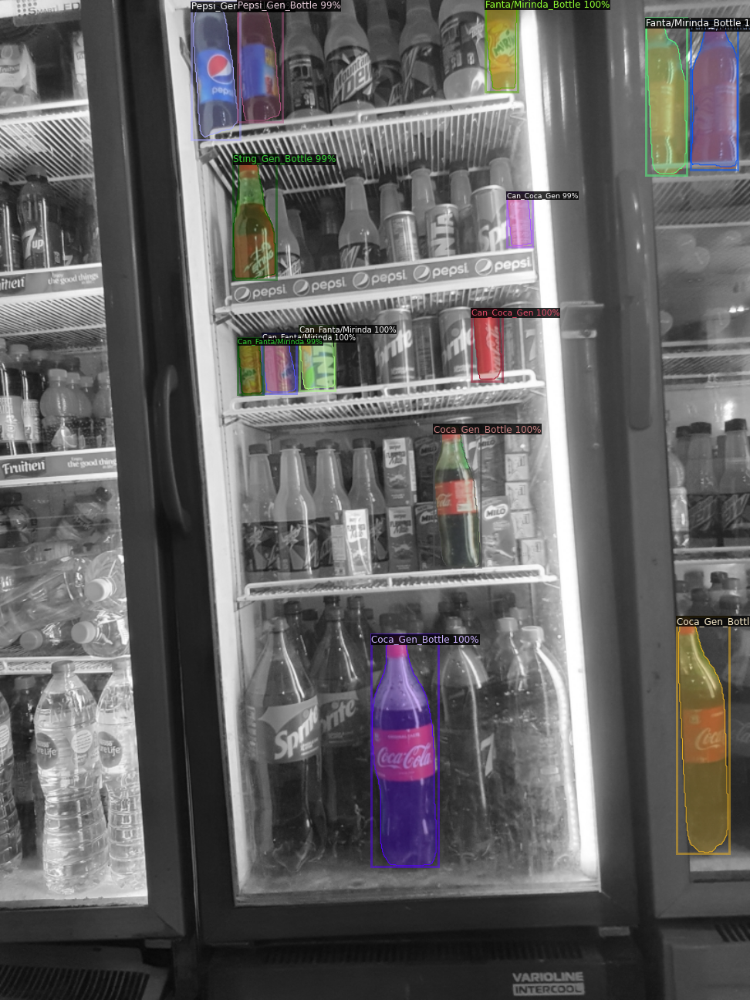

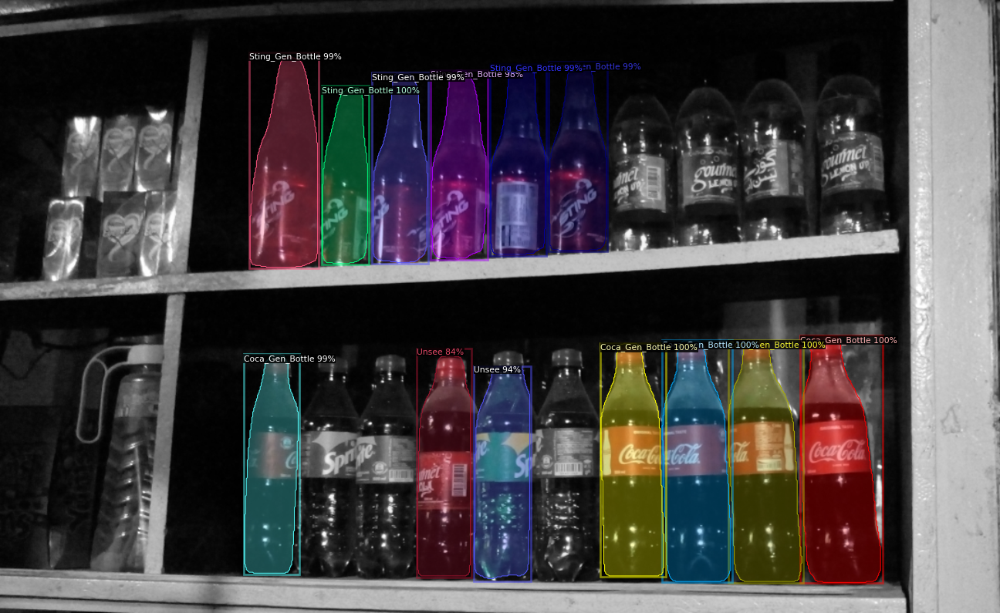

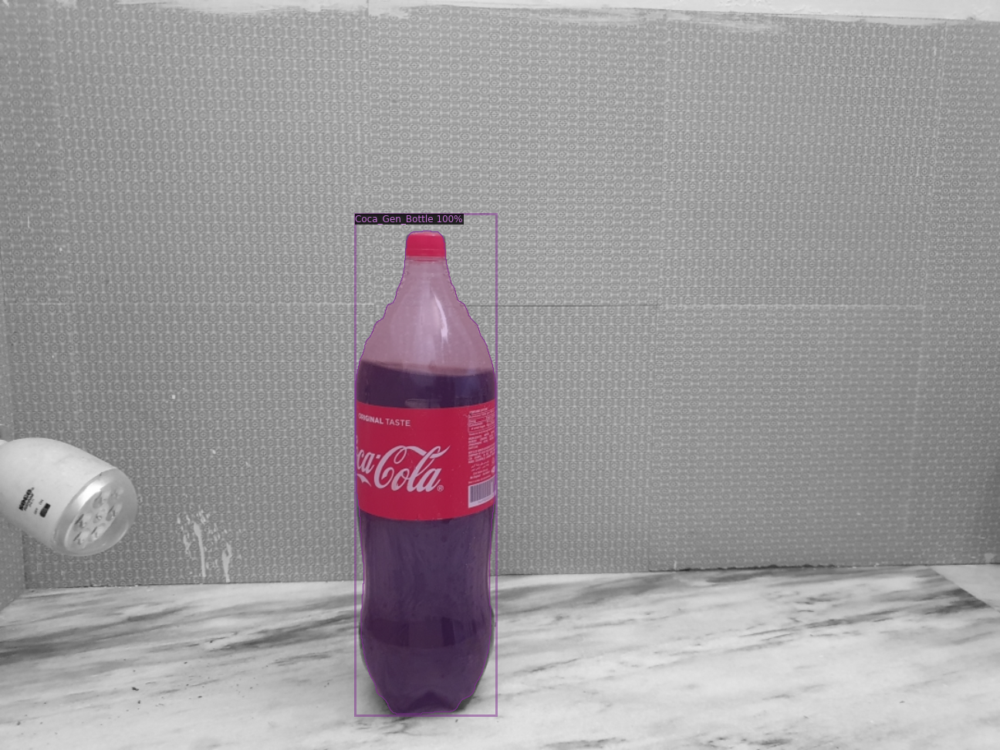

In [15]:
#@title
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = testing_threshold
cfg.DATASETS.TEST = (name_validate_dataset,) 
predictor = DefaultPredictor(cfg)

from detectron2.utils.visualizer import ColorMode

for d in random.sample(dataset_dicts, number_of_visualizations):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=dataset_metadata, 
                   scale=1.2, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])


**5. Test on Image and Export Parameters**


Specify the path of the image whose output parameters will be extracted to a csv file (examples below)


        '/content/drive/My Drive/TEVTA - Product Pictures/Halar_Mustafa_Pepsi_Diet/IMG_20200905_185422.jpg'
        '/content/drive/My Drive/TEVTA - Product Pictures/Aamer_Khan_COKE_and_PEPSI_ITEMS/5.jpeg'
        '/content/drive/My Drive/TEVTA - Product Pictures/hussnainimtiaz_bevarages(mix)/WhatsApp Image 2020-09-06 at 7.14.59 PM.jpeg'
        '/content/drive/My Drive/TEVTA - Product Pictures/UzairAhmad_CocaCola/Uzair_Ahmad_CocaCola_006.jpg'
        '/content/drive/My Drive/TEVTA - Product Pictures/HaseebAnwaar_Sprite_mix/IMG_20200914_195454.jpg'

In [8]:
export_to_csv = False # (True or False)
testing_threshold = 0.5  # (Select 0.0-1.0)
image_path = '/content/drive/My Drive/CocaColaDetection/Data/Train_Validate_Split/Images/Test_Set/coca-cola-350ml-247x247.jpg'

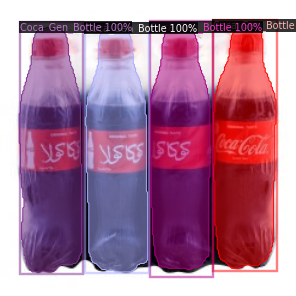

,Image,label,Width,Height,Class,xmin,ymin,xmax,ymax,x1_logical,y1_logical,x2_logical,y2_logical,confidence
0,/content/drive/My Drive/CocaColaDetection/Data...,Coca_Gen_Bottle,247,247,0,71.0,20.0,124.0,228.0,0.2868,0.0821,0.5028,0.9232,1.0
1,/content/drive/My Drive/CocaColaDetection/Data...,Coca_Gen_Bottle,247,247,0,16.0,19.0,69.0,229.0,0.0658,0.0777,0.2798,0.9262,1.0
2,/content/drive/My Drive/CocaColaDetection/Data...,Coca_Gen_Bottle,247,247,0,177.0,18.0,231.0,226.0,0.7184,0.0727,0.9356,0.9154,1.0
3,/content/drive/My Drive/CocaColaDetection/Data...,Coca_Gen_Bottle,247,247,0,125.0,19.0,177.0,231.0,0.5055,0.0774,0.718,0.9359,1.0


In [9]:
#@title 
import datetime
time= datetime.datetime.now() 

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = testing_threshold   # set the testing threshold for this model
cfg.DATASETS.TEST = (name_train_dataset,)
predictor = DefaultPredictor(cfg)

################################################
def image_show(im, predictor):
  v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])

def image_to_df(im, predictor):
  pred_obj = outputs['instances'].to('cpu')
  pred_obj_len = len(pred_obj)
  pred_obj_height = pred_obj._image_size[0]
  pred_obj_width = pred_obj._image_size[1]
  pred_obj_items = pred_obj._fields.items()
  results = []
  for idx in range(pred_obj_len):
    label = MetadataCatalog.get(cfg.DATASETS.TRAIN[0]).thing_classes[pred_obj.pred_classes[idx]]
    xmin,ymin,xmax,ymax = pred_obj.pred_boxes[idx].tensor.tolist()[0]
    x1_log,y1_log,x2_log,y2_log = round((xmin/pred_obj_width),4), round((ymin/pred_obj_height),4), round((xmax/pred_obj_width),4), round((ymax/pred_obj_height),4) 
    pred_class = pred_obj.pred_classes[idx].tolist()
    confidence = pred_obj.scores[idx].tolist()
    results.append(pd.Series([str(x) for x in [image_path, label, pred_obj_width, pred_obj_height, pred_class, round(xmin,0), round(ymin,0), round(xmax,0), round(ymax,0), x1_log, y1_log, x2_log, y2_log, round(confidence,2)]]))
  results_df = pd.DataFrame(results)
  try:
    results_df.columns = ['Image','label','Width','Height','Class','xmin','ymin','xmax', 'ymax', 'x1_logical', 'y1_logical', 'x2_logical', 'y2_logical', 'confidence']
    if export_to_csv is True:
      results_df.to_csv('/content/drive/My Drive/CocaColaDetection/Data/CSV_Exports/{}.csv'.format(re.findall(r'.+/(.+)\..+',image_path)[0]))
    return results_df
  except ValueError: 
    print("The image you have loaded might not have any match for the specified testing_threshold! (No dataframe)")
################################################

im = cv2.imread(image_path)
outputs = predictor(im)   # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
image_show(im, predictor)
image_to_df(im, predictor)

**Optional: Predict on a folder containing images** This may take some time if there are a lot of images  

In [10]:
#@title
path = '/content/drive/My Drive/TEVTA - Product Pictures/'
print('Folders in TEVTA Directory "{}" are:\n'.format(path))
os.listdir('/content/drive/My Drive/TEVTA - Product Pictures/')

Folders in TEVTA Directory "/content/drive/My Drive/TEVTA - Product Pictures/" are:



['hussnainimtiaz_bevarages(mix)',
 'UzairAhmad_CocaCola',
 'HaiderRiaz_Lays',
 'Aamer_Khan_PERSIL',
 'Aamer_Khan_COKE_and_PEPSI_ITEMS',
 'Aamer_Khan_MAGNUM',
 'Anbreen_Javed_Ariel',
 'M_Sameer_Rose_Petal_Tissue_Box',
 'HaseebAnwaar_Sprite_mix',
 'hussnainImtiaz_fanta(annotated)',
 'Halar_Mustafa_Pepsi_Diet',
 'Ammar_Pantene',
 'Muhammad_Akmal_Dove',
 'MuhammadRameezUrRahman_waterbottle',
 'Ayesha_Q_Mirinda',
 'AdnanIrshad_Pepsi']

Specify the folder path (from above cell output or specify your own path) and number of images to display 

In [11]:
folder_path = '/content/drive/My Drive/CocaColaDetection/Data/Train_Validate_Split/Images/Test_Set'
num_images_display = 9
testing_threshold = 0.5
#####
total_images = len(os.listdir(folder_path))
if num_images_display > total_images:
  raise ValueError('Update num_images_display. Total number of images in this directory are: ', total_images)

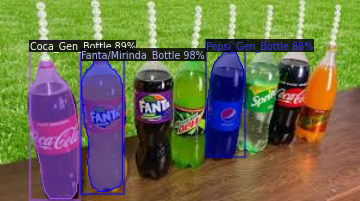

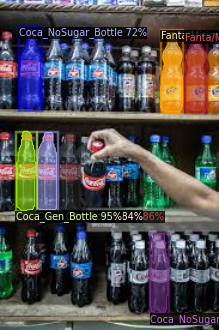

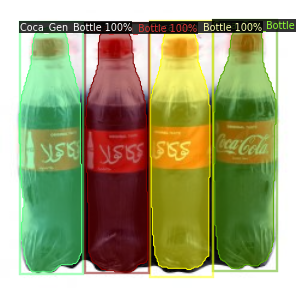

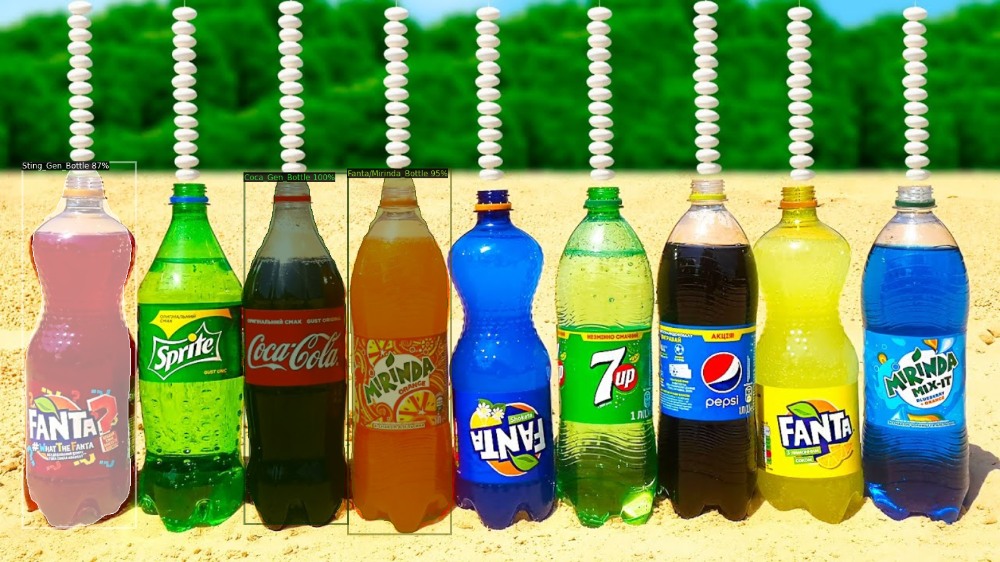

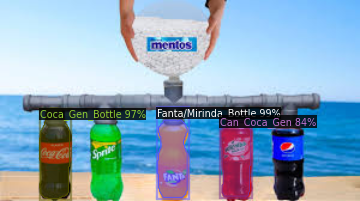

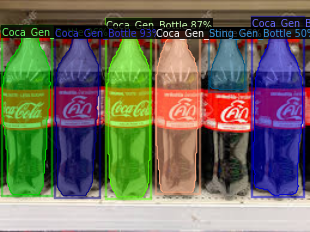

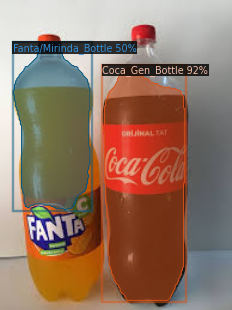

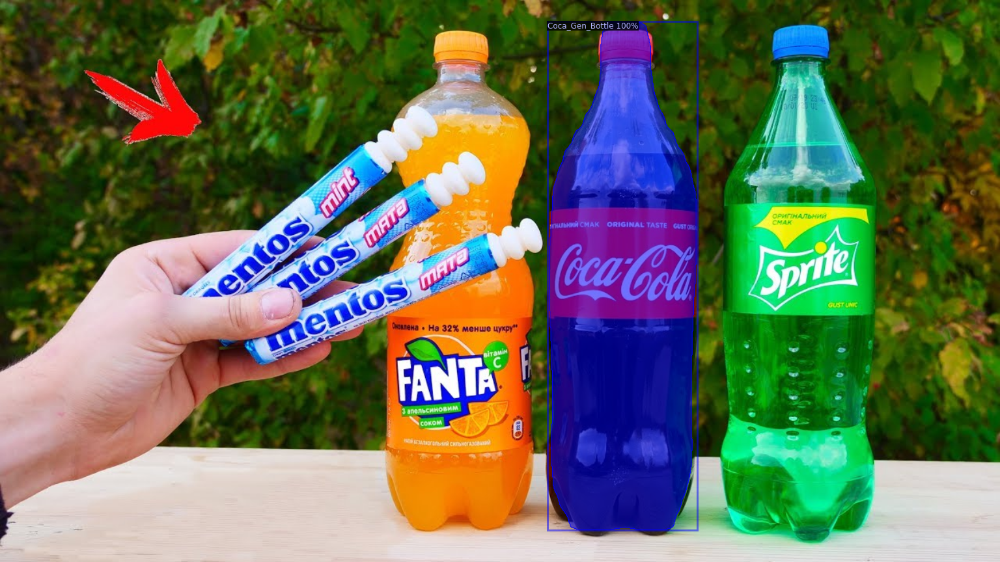

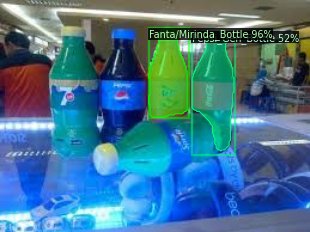

In [12]:
#@title

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = testing_threshold   # set the testing threshold for this model
cfg.DATASETS.TEST = (name_train_dataset,)
predictor = DefaultPredictor(cfg)

files=random.sample(os.listdir(folder_path), num_images_display)
for filename in files:
  im = cv2.imread(str(os.path.join(folder_path, filename)))
  outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
  v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])

"**6. Look at Training Curves**

In [13]:
#@title
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output
# if tensorboard already loaded and not showing use: %reload_ext tensorboard 

<IPython.core.display.Javascript object>

**SKIP Below Cells!!!** This section addressed exporting parameters from a list of 


In [ ]:
#@title
"""export_to_csv = False # (True or False)
testing_threshold = 0.5  # (Select 0.0-1.0)
image_paths = [
               '/content/drive/My Drive/TEVTA - Product Pictures/hussnainimtiaz_bevarages(mix)/WhatsApp Image 2020-09-06 at 7.15.21 PM.jpeg'
              ,'/content/drive/My Drive/CocaColaDetection/Data/Train_Validate_Split/Images/Test_Set/DXMD9M.jpg'
              ,'/content/drive/My Drive/CocaColaDetection/Data/Train_Validate_Split/Images/Test_Set/KED9T0.jpg'
]"""

In [ ]:
#@title 
"""import datetime
time= datetime.datetime.now() 

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = testing_threshold   # set the testing threshold for this model
cfg.DATASETS.TEST = (name_train_dataset,)
predictor = DefaultPredictor(cfg)

################################################
def image_show(im, predictor):
  v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])

def image_to_df(im, predictor):
  pred_obj = outputs['instances'].to('cpu')
  pred_obj_len = len(pred_obj)
  pred_obj_height = pred_obj._image_size[0]
  pred_obj_width = pred_obj._image_size[1]
  pred_obj_items = pred_obj._fields.items()
  results = []
  for idx in range(pred_obj_len):
    label = MetadataCatalog.get(cfg.DATASETS.TRAIN[0]).thing_classes[pred_obj.pred_classes[idx]]
    xmin,ymin,xmax,ymax = pred_obj.pred_boxes[idx].tensor.tolist()[0]
    x1_log,y1_log,x2_log,y2_log = round((xmin/pred_obj_width),4), round((ymin/pred_obj_height),4), round((xmax/pred_obj_width),4), round((ymax/pred_obj_height),4) 
    pred_class = pred_obj.pred_classes[idx].tolist()
    confidence = pred_obj.scores[idx].tolist()
    results.append(pd.Series([str(x) for x in [image_path, label, pred_obj_width, pred_obj_height, pred_class, round(xmin,0), round(ymin,0), round(xmax,0), round(ymax,0), x1_log, y1_log, x2_log, y2_log, round(confidence,2)]]))
  results_df = pd.DataFrame(results)
  try:
    results_df.columns = ['Image','label','Width','Height','Class','xmin','ymin','xmax', 'ymax', 'x1_logical', 'y1_logical', 'x2_logical', 'y2_logical', 'confidence']
    if export_to_csv is True:
      results_df.to_csv('/content/drive/My Drive/CocaColaDetection/Data/CSV_Exports/{}.csv'.format(re.findall(r'.+/(.+)\..+',image_path)[0]))
    return results_df
  except ValueError: 
    print("The image you have loaded might not have any match for the specified testing_threshold! (No dataframe)")
################################################

for image_path in image_paths:
  im = cv2.imread(image_path)
  outputs = predictor(im)   # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
  image_show(im, predictor)
  image_to_df(im, predictor)
  print(image_path)
"""